In [1]:
import pandas as pd
import numpy as np
import altair as alt
import plotly.express as px
import matplotlib.pyplot as plt

In [2]:
us_cat = pd.read_json('kaggle_data/US_category_id.json')
df = pd.read_csv('kaggle_data/USvideos.csv.zip')

In [3]:
items = []
for i in range(len(us_cat['items'])):
    temp = [
        int(us_cat['items'][i]['id']), us_cat['items'][i]['snippet']['title']
    ]
    items.append(temp)
df_cat = pd.DataFrame(items, columns=['id', 'Category'])
df_cat

,id,Category
0,1,Film & Animation
1,2,Autos & Vehicles
2,10,Music
3,15,Pets & Animals
4,17,Sports
5,18,Short Movies
6,19,Travel & Events
7,20,Gaming
8,21,Videoblogging
9,22,People & Blogs


In [4]:
df.dtypes

video_id                  object
trending_date             object
title                     object
channel_title             object
category_id                int64
publish_time              object
tags                      object
views                      int64
likes                      int64
dislikes                   int64
comment_count              int64
thumbnail_link            object
comments_disabled           bool
ratings_disabled            bool
video_error_or_removed      bool
description               object
dtype: object

In [5]:
df = df.merge(df_cat,left_on='category_id',right_on='id')
df.sample(10)

,video_id,trending_date,title,channel_title,category_id,publish_time,tags,views,likes,dislikes,comment_count,thumbnail_link,comments_disabled,ratings_disabled,video_error_or_removed,description,id,Category
24812,li5fmOV33hE,18.16.02,Best in Show Ceremony | WESTMINSTER DOG SHOW (...,FOX Sports,17,2018-02-14T06:29:02.000Z,"fox|""fox sports""|""fs1""|""fox sports 1""|""sports""...",52699,390,51,106,https://i.ytimg.com/vi/li5fmOV33hE/default.jpg,False,False,False,Watch the Best in Show ceremony from the 2018 ...,17,Sports
9868,kxkrdLI6e6M,18.05.04,How Dark Patterns Trick You Online,Nerdwriter1,24,2018-03-28T22:19:29.000Z,"the nerdwriter|""nerdwriter""|""nerdwriter youtub...",572314,36530,256,1282,https://i.ytimg.com/vi/kxkrdLI6e6M/default.jpg,False,False,False,Start protecting your internet experience toda...,24,Entertainment
5850,YiSsAjNtsFc,18.08.01,Checking Out the New McDonald’s Dollar Menu,TheReportOfTheWeek,24,2018-01-06T00:32:36.000Z,"reviewbrah|""mcdonalds""|""burger""|""sandwich""|""do...",229323,11241,515,2765,https://i.ytimg.com/vi/YiSsAjNtsFc/default.jpg,False,False,False,Trying out the new Dollar Menu from McDonald's...,24,Entertainment
38804,QBL8IRJ5yHU,18.22.05,Why I'm So Scared (being myself and crying too...,grav3yardgirl,26,2018-05-14T19:00:01.000Z,"beauty|""how to""|""makeup""|""howto""|""style""|""fash...",3575061,297520,13066,51547,https://i.ytimg.com/vi/QBL8IRJ5yHU/default.jpg,False,False,False,I will never be able to say Thank You enough.....,26,Howto & Style
20465,enH3xA4mYcY,18.21.03,SORRY TO BOTHER YOU | Official Trailer,Annapurna Channel,1,2018-03-11T21:59:46.000Z,"Tessa Thompson|""Armie Hammer""|""Lakeith Stanfie...",2066539,7898,274,581,https://i.ytimg.com/vi/enH3xA4mYcY/default.jpg,False,False,False,IN THEATERS JULY 6. In an alternate present-da...,1,Film & Animation
10333,Pj-D0jc17D0,18.21.04,Diner Lobster - SNL,Saturday Night Live,24,2018-04-15T06:56:43.000Z,"SNL|""Saturday Night Live""|""SNL Season 43""|""SNL...",2224831,38485,1155,2118,https://i.ytimg.com/vi/Pj-D0jc17D0/default.jpg,False,False,False,A man (Pete Davidson) surprises everyone (John...,24,Entertainment
25693,hRnVb4z6Hw0,18.06.05,Stephen A. hilariously goes off on Max for cha...,ESPN,17,2018-04-30T14:59:38.000Z,"espn|""pelicans warriors""|""pelicans vs warriors...",754817,8430,410,2533,https://i.ytimg.com/vi/hRnVb4z6Hw0/default.jpg,False,False,False,First Take's Stephen A. Smith hilariously goes...,17,Sports
35345,hGoQ44SfV-c,17.28.11,Daisy Ridley Builds A Millennium Falcon (While...,ELLEUKTV,26,2017-11-24T11:54:11.000Z,[none],499890,6300,659,1647,https://i.ytimg.com/vi/hGoQ44SfV-c/default.jpg,False,False,False,'I think I'm missing a piece' \n\nProduction: ...,26,Howto & Style
31255,tjA7nAHOAww,18.17.05,"LSD - Audio ft. Sia, Diplo, Labrinth",SiaVEVO,10,2018-05-10T12:00:03.000Z,"Audio lsd|""Diplo""|""Sia""|""Labrinth""|""LSD""|""LSD ...",6988087,279205,3666,11320,https://i.ytimg.com/vi/tjA7nAHOAww/default.jpg,False,False,False,"Labrinth, Sia & Diplo present LSD - Audio (Off...",10,Music
7141,HgjVWV0Uw3M,18.07.02,Did Solo: A Star Wars Story Trailer Win Over F...,ColliderVideos,24,2018-02-05T18:27:19.000Z,"tobeornottobethatisthequestion|""Solo A Star Wa...",88867,2544,271,1621,https://i.ytimg.com/vi/HgjVWV0Uw3M/default.jpg,False,False,False,On this episode of Collider Movie Talk (Monday...,24,Entertainment


In [6]:
df['publish_time'] = pd.to_datetime(df['publish_time'])

In [7]:
df.sample(5).T

,11977,17921,28094,7083,14397
video_id,CPjWgk0UXps,-p-PToD2URA,rll790aP60Q,LkpZFd2pZqY,jwkNAJBwoEA
trending_date,18.22.05,18.02.03,18.23.01,18.06.02,18.22.01
title,I Got My Apartment Professionally Organized,PAZ Mission,Justin Timberlake and Zane Lowe on Beats 1 [Pa...,This Is Us - Aftershow: Season 2 Episode 14 (D...,The Friend Zone | Anwar Jibawi
channel_title,Michelle Khare,SpaceX,Beats 1 Radio,This Is Us,Anwar Jibawi
category_id,24,28,10,24,23
publish_time,2018-05-11 15:00:01+00:00,2018-02-22 14:52:02+00:00,2018-01-18 17:19:33+00:00,2018-02-05 04:47:31+00:00,2018-01-17 17:00:13+00:00
tags,"michelle khare|""buzzfeed michelle""|""organize""|...",[none],"Justin Timberlake|""JT""|""Man of the Woods""|""Zan...","this is us|""this is us 214""|""this is us jack""|...","the friend zone|""anwar""|""jibawi""|""the""|""friend..."
views,1355564,1868613,126610,134863,2250553
likes,31912,40531,1564,1843,98953
dislikes,1564,1189,87,29,1973


# Comments

In [21]:
df['comments_disabled'] = df['comments_disabled'].astype(str)
df['ratings_disabled'] = df['ratings_disabled'].astype(str)
df['video_error_or_removed'] = df['video_error_or_removed'].astype(str)

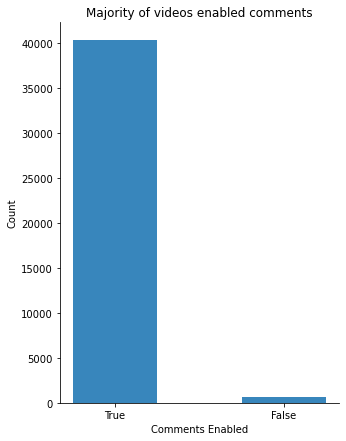

In [53]:
fig, ax = plt.subplots(figsize=(5,7))

ax.hist(df.comments_disabled, bins=range(3), rwidth=0.5, align='left', alpha=0.89)
plt.xticks(range(2))

ax.set_xticklabels(['True','False'])

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

plt.xlabel('Comments Enabled')
plt.ylabel('Count')
plt.title('Majority of videos enabled comments')
plt.show()

# Ratings

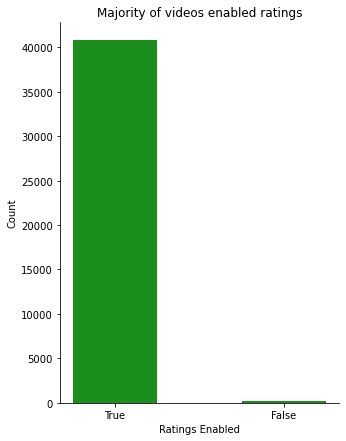

In [56]:
fig, ax = plt.subplots(figsize=(5,7))

ax.hist(df.ratings_disabled, bins=range(3), rwidth=0.5, align='left', color='green',alpha=0.89)
plt.xticks(range(2))

ax.set_xticklabels(['True','False'])

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

plt.xlabel('Ratings Enabled')
plt.ylabel('Count')
plt.title('Majority of videos enabled ratings')
plt.show()

# Categories

In [8]:
df_cat = df[['id','Category']].groupby(by=['Category']).count()
df_cat = df_cat.reset_index()
df_cat['percent_id'] = df_cat['id'] / df_cat['id'].sum()
df_cat

,Category,id,percent_id
0,Autos & Vehicles,384,0.009378
1,Comedy,3457,0.084422
2,Education,1656,0.040441
3,Entertainment,9964,0.243327
4,Film & Animation,2345,0.057266
5,Gaming,817,0.019952
6,Howto & Style,4146,0.101248
7,Music,6472,0.158050
8,News & Politics,2487,0.060734
9,Nonprofits & Activism,57,0.001392


In [9]:
bar = alt.Chart(df_cat, title='Percentages of Category').mark_bar().encode(
    x=alt.X('id:Q', title='Count', scale=alt.Scale(domain=(0, 11000))),
    y=alt.Y('Category', sort='-x'),
    color=alt.Color('id:Q', scale=alt.Scale(scheme='purplebluegreen'), legend=alt.Legend(titleOrient='top', tickCount=4, title = 'Count'))
).properties(height=500)

text = alt.Chart(df_cat).mark_text(dx=20, dy=0, color='Black').encode(
    x=alt.X('id:Q', title='Count', scale=alt.Scale(domain=(0, 11000))),
    y=alt.Y('Category', sort='-x'),
    text=alt.Text('percent_id', format='.1%')
)

alt.layer(bar, text).configure_view(
    stroke='transparent'
).configure_axis(
    labelFontSize=12,
    titleFontSize=16
).configure_title(
    fontSize=20)

alt.LayerChart(...)

# Top Channels

In [10]:
# Top 20 channels 
df_cha = df[['id','channel_title']].groupby(by=['channel_title']).count()
df_cha = df_cha.reset_index()
df_cha['percent_id'] = df_cha['id'] / df_cha['id'].sum()
df_cha = df_cha.sort_values(by='id', ascending = False)
df_cha[:20]

,channel_title,id,percent_id
555,ESPN,203,0.004957
1785,The Tonight Show Starring Jimmy Fallon,197,0.004811
1943,Vox,193,0.004713
1271,Netflix,193,0.004713
1804,TheEllenShow,193,0.004713
1753,The Late Show with Stephen Colbert,187,0.004567
889,Jimmy Kimmel Live,186,0.004542
1009,Late Night with Seth Meyers,183,0.004469
1556,Screen Junkies,182,0.004445
1239,NBA,181,0.004420


In [11]:
bar = alt.Chart(df_cha, title='Channel').mark_bar().encode(
    x=alt.X('id:Q', title='Count'),
    y=alt.Y('channel_title', sort='-x', axis=alt.Axis(labels=False)),
    color=alt.Color('id:Q', scale=alt.Scale(scheme='redyellowblue'), legend=alt.Legend(titleOrient='top', tickCount=4, title = 'Count'))
).properties(height=500)
bar

alt.Chart(...)

In [12]:
bar = alt.Chart(df_cha[:20], title='Top 20 Channels').mark_bar().encode(
    x=alt.X('id:Q', title='Count'),
    y=alt.Y('channel_title', sort='-x', title = 'Channel Title'),
    color=alt.Color('id:Q', scale=alt.Scale(scheme='yelloworangered'), legend=alt.Legend(titleOrient='top', tickCount=4, title = 'Count'))
).properties(height=500)
bar

text = alt.Chart(df_cha[:20]).mark_text(dx=15, dy=0, color='Black').encode(
    x=alt.X('id:Q', title='Count'),
    y=alt.Y('channel_title', sort='-x'),
    text=alt.Text('id')
)

alt.layer(bar, text).configure_view(
    stroke='transparent'
).configure_axis(
    labelFontSize=12,
    titleFontSize=16
).configure_title(
    fontSize=20)

alt.LayerChart(...)

# Likes and dislikes 

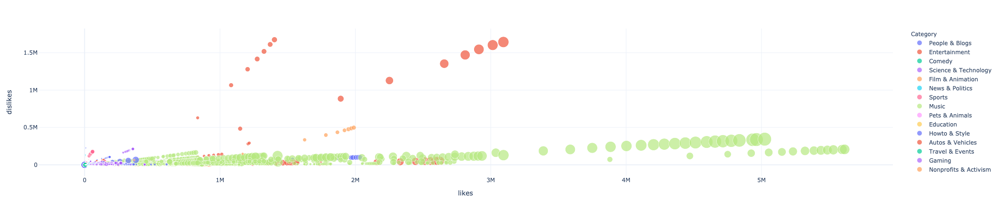

In [13]:
fig = px.scatter(df, x="likes", y="dislikes", size="views", hover_name='title', color='Category',template='plotly_white')
fig.show()

In [14]:
df['ratio_likes_dislikes'] = df['likes'] / df['dislikes']

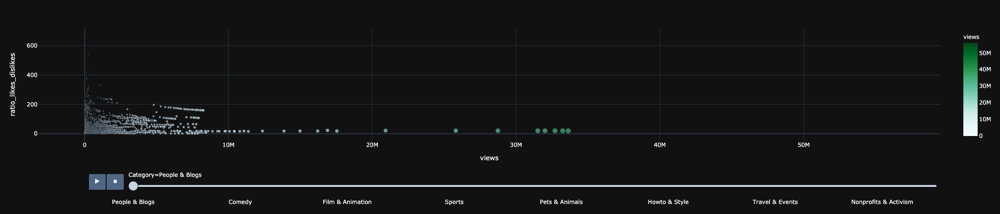

In [15]:
fig = px.scatter(df, 
                 x="views", 
                 y="ratio_likes_dislikes", 
                 hover_name='title', 
                 animation_frame='Category',
                 template='plotly_', 
                 color='views', 
                 size='views',
                 color_continuous_scale=px.colors.sequential.BuGn)
fig.show()

# Correlation Matrix Map

In [16]:
corr = df.corr()
cor_data = (corr.stack()
                .reset_index()     # The stacking results in an index on the correlation values, we need the index as normal columns for Altair
                .rename(columns={0: 'correlation', 'level_0': 'variable', 'level_1': 'variable2'}))
cor_data['correlation'] = cor_data['correlation'].map('{:.2f}'.format)
cor_data

,variable,variable2,correlation
0,category_id,category_id,1.00
1,category_id,views,-0.17
2,category_id,likes,-0.17
3,category_id,dislikes,-0.03
4,category_id,comment_count,-0.08
...,...,...,...
93,ratio_likes_dislikes,comment_count,0.02
94,ratio_likes_dislikes,comments_disabled,-0.06
95,ratio_likes_dislikes,video_error_or_removed,-0.00
96,ratio_likes_dislikes,id,-0.07


In [17]:
base = alt.Chart(cor_data).encode(
    x='variable2:O',
    y='variable:O',
)

text = base.mark_text().encode(
    text='correlation',
    color=alt.condition(
        alt.datum.correlation > 0.5, 
        alt.value('white'),
        alt.value('black')
    )
)

cor_plot = base.mark_rect().encode(
    color=alt.Color('correlation:Q', scale=alt.Scale(scheme='lightgreyteal'))
).properties(
    width=500,
    height=300
)

cor_plot + text

alt.LayerChart(...)